# Tutorial: **Hierarchical modeling with repeated binary trial data**

In this tutorial we will demonstrate the application of hierarchical models
with data from the 1970 season of [Major League Baseball (MLB)](#references)
found in the paper by [Efron and Morris 1975](#references).

## Learning Outcomes

On completion of this tutorial, you should be able:

* to prepare data for running a hierarchical model with Bean Machine;
* to execute a hierarchical model with Bean Machine;
* to explain what different pooling techniques tell us about the data; and
* to run diagnostics to understand what Bean Machine is doing.

## Problem

Data are from [Efron and Morris 1975](#references), which are taken from the
1970 Major League Baseball season for both the American and National leagues,
[Wikipedia (Major League Baseball)](#references). These data are an example of
repeated binary trials in that a player has multiple opportunities (trials)
for being at-bat and they can either land a hit or miss the ball (binary
outcome). Many useful scenarios can be modeled as having repeated binary
trials. For example; browser click data, watching a video to completion, voting
for or against propositions in a session of congress/parliament, and even rat
tumor development, see [Tarone](#references).

Our task is to use the given baseball data and create a hierarchical model
that estimates the chances each player has to land a hit when they are at-bat.

## Prerequisites

We wil be using the following packages within this tutorial.

* [`arviz`](https://arviz-devs.github.io/arviz/) and
  [`bokeh`](https://docs.bokeh.org/en/latest/docs/) for interactive visualizations; and
* [`pandas`](https://pandas.pydata.org/) for data manipulation.

In [1]:
import os
from io import StringIO

import arviz as az
import beanmachine.ppl as bm
import pandas as pd
import torch
import torch.distributions as dist
from beanmachine.ppl.inference import VerboseLevel
from beanmachine.ppl.model import RVIdentifier
from bokeh.io import output_notebook
from bokeh.plotting import gridplot, show
from IPython.display import SVG

from utils import baseball
smoke_test = ('SANDCASTLE_NEXUS' in os.environ or 'CI' in os.environ)

The next cell includes convenient configuration settings to improve the notebook
presentation as well as setting a manual seed for `torch` for reproducibilty.

In [2]:
# Plotting settings
az.rcParams["plot.backend"] = "bokeh"
az.rcParams["plot.bokeh.figure.dpi"] = 60
az.rcParams["stats.hdi_prob"] = 0.89

# Manual seed for torch
torch.manual_seed(1199)

# Other settings for the notebook
output_notebook()

Loading BokehJS ...

## Data

We explore the data below to help inform our decisions about priors and sampling
distributions for our models. The insights will be used to create logical
procedures for processing information, see [McElreath](#references) for further
discussion about creating data stories, and their importance for model building.

The raw data contain the following columns.

| Column name          | Description                                     |
| -------------------- | ----------------------------------------------- |
| **FirstName**        | Player's first name                             |
| **LastName**         | Player's last name                              |
| **At-Bats**          | 45 for each player                              |
| **Hits**             | Hits in first 45 at-bats                        |
| **BattingAverage**   | Batting average after first 45 at-bats          |
| **RemainingAt-Bats** | Batting average for the remainder of the season |
| **SeasonAt-Bats**    | Number of at-bats for entire season             |
| **Season Hits**      | Number of hits for entire season                |
| **SeasonAverage**    | Batting average for entrie season               |

The selected players include _Roberto Clemente_ explicitly because he was
presumed to be an outlier. See [Efron and Morris, 1977](#references) for
further discussion.

We now read the data in as a `pandas` dataframe. The data are replicated below
using a `StringIO` object rather than reading from a `CSV` file.

In [3]:
# Data are from Efron and Morris (1975).
data_string = """FirstName,LastName,At-Bats,Hits,BattingAverage,RemainingAt-Bats,RemainingAverage,SeasonAt-Bats,Season Hits,SeasonAverage
Roberto,Clemente,45,18,0.4,367,0.346,412,145,0.352
Frank,Robinson,45,17,0.378,426,0.2981,471,144,0.306
Frank,Howard,45,16,0.356,521,0.2764,566,160,0.283
Jay,Johnstone,45,15,0.333,275,0.2218,320,76,0.238
Ken,Berry,45,14,0.311,418,0.2727,463,128,0.276
Jim,Spencer,45,14,0.311,466,0.2704,511,140,0.274
Don,Kessinger,45,13,0.289,586,0.2645,631,168,0.266
Luis,Alvarado,45,12,0.267,138,0.2101,183,41,0.224
Ron,Santo,45,11,0.244,510,0.2686,555,148,0.267
Ron,Swaboda,45,11,0.244,200,0.23,245,57,0.233
Rico,Petrocelli,45,10,0.222,538,0.2639,583,152,0.261
Ellie,Rodriguez,45,10,0.222,186,0.2258,231,52,0.225
George,Scott,45,10,0.222,435,0.3034,480,142,0.296
Del,Unser,45,10,0.222,277,0.2635,322,83,0.258
Billy,Williams,45,10,0.222,591,0.3299,636,205,0.251
Bert,Campaneris,45,9,0.2,558,0.2849,603,168,0.279
Thurman,Munson,45,8,0.178,408,0.3162,453,137,0.302
Max,Alvis,45,7,0.156,70,0.2,115,21,0.183"""
with StringIO(data_string) as f:
    df = pd.read_csv(f)

The next cell contains standard `pandas` transformations to make the data
clearer for later analysis. We also rename a few columns for readability.

In [4]:
# Rename columns in order to make the data clearer.
renames = {
    "Hits": "Current hits",
    "At-Bats": "Current at-bats",
    "Season Hits": "Season hits",
    "SeasonAt-Bats": "Season at-bats",
}
df = df.rename(columns=renames)

# Concatenate the first and last names together.
df["Name"] = df["FirstName"].str.cat(df["LastName"], sep=" ")

# Keep only those columns we will use in the analysis.
df = df[
    ["Name", "Current hits", "Current at-bats", "Season hits", "Season at-bats"]
].copy()

# Show the resultant dataframe.
df.set_index("Name")

,Current hits,Current at-bats,Season hits,Season at-bats
Name,,,,
Roberto Clemente,18,45,145,412
Frank Robinson,17,45,144,471
Frank Howard,16,45,160,566
Jay Johnstone,15,45,76,320
Ken Berry,14,45,128,463
Jim Spencer,14,45,140,511
Don Kessinger,13,45,168,631
Luis Alvarado,12,45,41,183
Ron Santo,11,45,148,555


The above dataframe shows us that each player had a different number of
opportunities to be at-bat over the course of the season; the `Season at-bats`
column. We also see a defined slice in time where all the players have had the
same number of opportunities to be at-bat, the `Current at-bats` column, which
is all 45. The number of successful hits a player has made within the first 45
trials is given in the `Current hits` column, as well as the total number of
hits for the season in `Season hits`.

Below we see an ordered scatter plot of the `Current hits` column.

In [5]:
show(baseball.plot_current_hits(df))

The data are telling us that each player is unique (there are not a lot with
the same number of hits), but also that they are similar. The players are
similar because they are all highly trained in their sport, and have a much
better chance of hitting a ball when at-bat then an average person not in the
MLB. The data also tell us that we have captured a slice in time where each
player has been given the same number of opportunities to be at-bat, and all of
them had different amounts of success at landing a hit. We can estimate the
chance a player has at hitting a ball when at-bat.

## Models

We will create three separate models using the above data as we explore how to
create a hierarchical model using Bean Machine. The models we will be creating
are:

* [complete-pooling](#complete-pooling);
* [no-pooling](#no-pooling);
* [partial-pooling](#parital-pooling).

Each model will estimate a baseball player's chance of landing a hit when they
are at-bat. We can assume that every time a player is at-bat is a new
independent Bernoulli trial (see [Wikipedia (Bernoulli trial)](#references)) so
we can model the chance a player has when at-bat as a Binomial distribution,
see [Wikipedia (Binomial)](#references).

$$
p(y_n | \phi) = \text{Binomial}(y_n | K_n, \phi)
$$

where

* $\phi$ is our prior;
* $y_n$ are the number of times a player makes a hit (number of successes);
* $K_n$ is the number of times that player has been at-bat (number of trials).

**`NOTE`** We can implement this model in Bean Machine by defining random
variable objects with the `@bm.random_variable` and `@bm.functional`
decorators. These functions behave differently than ordinary Python functions.

<div style="background: #daeaf3; border-left: 3px solid #2980b9; display: block; margin: 16px 0; padding: 12px;">
  Semantics for <code>@bm.random_variable</code> functions:
  <ul>
    <li>They must return PyTorch <code>Distribution</code> objects.</li>
    <li>
      Though they return distributions, callees actually receive a
      <i>sample</i> from the distribution. The machinery for obtaining samples
      from distributions is handled internally by Bean Machine.
    </li>
    <li>
      Inference runs the model through many iterations. During a particular
      inference iteration, a distinct random variable will correspond to
      exactly one sampled value: <b>calls to the same random variable function
      with the same arguments will receive the same sampled value within one
      inference iteration</b>. This makes it easy for multiple components of
      your model to refer to the same logical random variable.
    </li>
    <li>
      Consequently, to define distinct random variables that correspond to
      different sampled values during a particular inference iteration, an
      effective practice is to add a dummy "indexing" parameter to the
      function. Distinct random variables can be referred to with different
      values for this index.
    </li>
      <li>
        Please see the documentation for more information about this decorator.
      </li>
  </ul>

  Semantics for <code>@bm.random_variable</code> functions:
  <ul>
    <li>
       This is a decorator that let's you treat deterministic code as if it's a
       Bean Machine random variable. This is used to transform the results of
       one or more random variables
    </li>
    <li>
        This follows the same naming practice as
        <code>@bm.random_variable</code> where variables are distinguished by
        their argument call values.
    </li>
  </ul>
</div>

<a id="complete-pooling"></a>
### Complete-pooling model

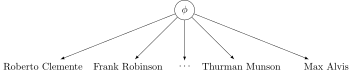

In [6]:
SVG("assets/baseball/complete-pooling-dag.svg")

The image above is a graphical representation of what complete pooling does: it
assumes that everyone's chance of landing a hit is sampled from the same
population distribution $\phi$. This model assumes that all the player's
chances of hitting a ball are the _same_, which is an extreme statement
compared to our data story that said all players were _similar_. This is
something we will fix in later model.

If we assume no prior knowledge about the players then our prior ($\phi$) is a
uniform distribution from $[0, 1]$. Bean Machine works well with `Uniform`
priors, but we will choose to use a $\text{Beta(1, 1)}$ distribution as our
prior because it is a conjugate prior to a Binomial distribution. Our
`complete-pooling` model can be written as

$$
\begin{align}
  \phi & \sim\text{Beta}(1, 1)\\
  y    & \sim\text{Binomial}(K, \phi).
\end{align}
$$

#### Beta priors _vs_ Uniform priors

Below we can see why swapping a `Uniform` distribution for a `Beta(1, 1)` is
appropriate as they are the same.

In [7]:
show(baseball.plot_complete_pooling_priors())

We can create our `complete-pooling` model in Bean Machine using the
`@bm.random_variable` decorator.

In [8]:
N = df.shape[0]
current_at_bats = torch.tensor(df["Current at-bats"].astype(float).values)
current_hits = torch.tensor(df["Current hits"].astype(float).values)


@bm.random_variable
def complete_pooling_phi() -> RVIdentifier:
    return dist.Beta(1, 1)


@bm.random_variable
def complete_pooling_y() -> RVIdentifier:
    return dist.Binomial(current_at_bats, complete_pooling_phi().expand((N,)))

In the code cell above we have defined our population prior and chance of
landing a hit when at-bat in the top-level namespace of our notebook. Bean
Machine can take advantage of creating models as classes as well, and we
illustrate how to do that below for our `complete-pooling` model. We will not
use the class method for the rest of the tutorial, however, it does show you
how to accomplish creating the model as a class object in Python.

We make use of the `expand` method on pytorch distribution objects to perform
batch sampling. This has the advantage of being more computationally-efficient
than explicit iteration. Bean Machine is also able to take advantage of the
implicit broadcasting of pytorch tensors and pytorch samplers like
`dist.Binomial` allowing us to sample or observe all $y$ values at once.

In [9]:
class CompletePoolingModel:
    @bm.random_variable
    def complete_pooling_phi(self) -> RVIdentifier:
        return dist.Beta(1, 1)

    @bm.random_variable
    def complete_pooling_y(self, i: int, k: int) -> RVIdentifier:
        return dist.Binomial(k, self.complete_pooling_phi())


complete_pooling_model = CompletePoolingModel()

#### Complete-pooling inference

Inference is the process of combining model and data to obtain insights, in the
form of probability distributions over values of interest. Bean Machine offers
a powerful and general inference framework to enable fitting arbitrary models
to data.

Our inference algorithms expect a dictionary where the keys are
`@bm.random_variable` invocations, and tensor data as our observational values.
You can see this in the example below.

In [10]:
complete_pooling_observations = {complete_pooling_y(): current_hits}
complete_pooling_observations

{RVIdentifier(wrapper=<function complete_pooling_y at 0x7fc5ff623af0>, arguments=()): tensor([18., 17., 16., 15., 14., 14., 13., 12., 11., 11., 10., 10., 10., 10.,
         10.,  9.,  8.,  7.], dtype=torch.float64)}

We are ready to run inference on our model and observations. Bean Machine
supports a rich library of inference algorithms that share a common `infer`
method with the following arguments:

| Name           | Usage                                                                                         |
|----------------|-----------------------------------------------------------------------------------------------|
| `queries`      | A list of @bm.random_variable targets to fit posterior distributions for.                     |
| `observations` | The Dict of observations we built up, above.                                                  |
| `num_samples`  | Number of samples to build up distributions for the values listed in queries.                 |
| `num_chains`   | Number of separate inference runs to use. Multiple chains can verify inference ran correctly. |

For this particular problem, we will use the `GlobalNoUTurnSampler`
inference method. Bean Machine's `GlobalNoUTurnSampler` is the NUTS sampler you
have probably used before with `stan` or `pymc3`. We have chosen to use the NUTS
sampler here because it can be easily compared to other probabilistic tools.

In [11]:
num_samples = 2 if smoke_test else 5000
num_adaptive_samples = 0 if smoke_test else 2500

complete_pooling_queries = [complete_pooling_phi()]

complete_pooling_samples = bm.GlobalNoUTurnSampler().infer(
    queries=complete_pooling_queries,
    observations=complete_pooling_observations,
    num_samples=num_samples,
    num_chains=4,
    num_adaptive_samples=num_adaptive_samples,
    verbose=VerboseLevel.OFF,
)

#### Complete-pooling analysis

The `complete_pooling_samples` object contains our inference results. We have
only one parameter in this model, $\phi$, which was supplied as a single query
parameter when we ran inference. After inference has been run, we need to
ensure our model has fit the data appropriately. We begin this analysis by
printing out summary statistics with two important statistics $\hat{R}$
(`r_hat`) and effective sample size (`ess`) values, see [Vehtari _et
al_](#references).

In [12]:
complete_pooling_summary_df = az.summary(
    complete_pooling_samples.to_xarray(),
    round_to=4,
)
complete_pooling_summary_df

,mean,sd,hdi_5.5%,hdi_94.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
complete_pooling_phi(),0.266,0.0157,0.2406,0.2907,0.0002,0.0002,4098.1733,1870.2206,1.0009


#### Measuring variance between- and within-chains with $\hat{R}$ (`r_hat`)

$\hat{R}$ is a diagnostic tool that measures the between- and within-chain
variances. It is a test that indicates a lack of convergence by comparing the
variance between multiple chains to the variance within each chain. If the
parameters are successfully exploring the full space for each chain, then
$\hat{R}\approx 1$, since the between-chain and within-chain variance should be
equal. $\hat{R}$ is calculated from $N$ samples as

$$
\hat{R}=\frac{\hat{V}}{W} \\
\hat{V} = \frac{N-1}{N} W + \frac{1}{N} B
$$

where $W$ is the within-chain variance, $B$ is the between-chain variance
and $\hat{V}$ is the estimate of the posterior variance of the samples.
The take-away here is that $\hat{R}$ converges to 1 when each of the chains
begins to empirically approximate the same posterior distribution. We do not
recommend using inference results if $\hat{R}>1.01$. More information
about $\hat{R}$ can be found in the [Vehtari _et al_](#references) paper.

#### Effective sample size (`ess`)

MCMC samplers do not draw truly independent samples from the target
distribution, which means that our samples are correlated. In an ideal
situation all samples would be independent, but we do not have that luxury. We
can, however, measure the number of _effectively independent_ samples we draw,
which is called the effective sample size (ess). You can read more about how
this value is calculated in the [Vehtari _et al_](#references) paper. In brief,
it is a measure that combines information from the $\hat{R}$ value with the
autocorrelation estimates within the chains.

ESS estimates come in two variants, `ess_bulk` and `ess_tail`. The former is
the default, but the latter can be useful if you need good estimates of the
tails of your posterior distribution. The rule of thumb for `ess_bulk` is for
this value to be greater than 100 per chain on average. Since we ran four
chains, we need `ess_bulk` to be greater than 400 for each parameter. The
`ess_tail` is an estimate for effectively independent samples considering the
more extreme values of the posterior. This is not the number of samples that
landed in the tails of the posterior, but rather a measure of the number of
effectively independent samples if we sampled the tails of the posterior. The
rule of thumb for this value is also to be greater than 100 per chain on
average.

We can use `arviz` to plot the evolution of the `ess` for both the bulk and
tail regions of our posterior as well as autocorrelation plots for our queries.
Investigating these plots along with the `ess` and $\hat{R}$ values will help
you determine if the model is fitting the data appropriately.

In [13]:
data = {"φ": complete_pooling_samples.get(complete_pooling_phi()).numpy()}
f = az.plot_ess(data, kind="evolution", show=False)[0][0]
f.plot_width = 600
f.plot_height = 400
f.y_range.start = 0
f.outline_line_color = "black"
f.grid.grid_line_alpha = 0.2
f.grid.grid_line_color = "grey"
f.grid.grid_line_width = 0.2
show(f)

When the model is converging properly, both the bulk and tail lines from the
`ess` evolution plot should be _roughly_ linear. We can see that both the
`ess_bulk` and `ess_tail` are above the rule-of-thumb value of 400 (the red
dashed line), which indicates that the model is fitting the data.

Below we have two more diagnostic plots for individual random variables: Rank
plots and autocorrelation plots.

* `Rank plots` are a histogram of the samples over time. All samples across all
  chains are ranked and then we plot the average rank for each chain on regular
  intervals. If the chains are mixing well this histogram should look roughly
  uniform. If it looks highly irregular that suggests chains might be getting
  stuck and not adequately exploring the sample space.

* `Autocorrelation plots` measure how predictive the last several samples are
  of the current sample. Autocorrelation may vary between -1.0
  (deterministically anticorrelated) and 1.0 (deterministically correlated). We
  compute autocorrelation approximately, so it may sometimes exceed these
  bounds. In an ideal world, the current sample is chosen independently of the
  previous samples: an autocorrelation of zero. This is not possible in
  practice, due to stochastic noise and the mechanics of how inference works.

In [14]:
show(gridplot([baseball.plot_complete_pooling_diagnostics(complete_pooling_samples)]))

The first figure is the distribution for each chain we ran inference for. We
can see the distributions look well behaved (_i.e._ there are not a lot of
oscillations). Next to the distribution plot is the rank plot we discussed
above. We can see from the histograms for each chain that these plots all look
fairly uniform. The black dashed line is used as a guide to ensure the bars are
uniform. Finally next to the rank plot are the autocorrelation plots for each
chain for this query. We can see some correlations, but overall the plots show
the chains have mixed.

Below we plot our final diagnostic, which is the posterior for our parameter
$\phi$. Here we see an interval of 89% that defines the highest density
interval (HDI), which tells us where the greatest amount of density for the
posterior lies. Why an 89% HDI instead of 95%? To prevent you from thinking
about a 95% confidence interval. See [McElreath](#references) for further
discussion on this subject.

In [15]:
complete_pooling_phi_posterior = az.plot_posterior(
    {"φ": complete_pooling_samples.get(complete_pooling_phi()).numpy()},
    show=False,
)[0][0]
complete_pooling_phi_posterior.plot_width = 400
complete_pooling_phi_posterior.plot_height = 400
complete_pooling_phi_posterior.y_range.start = 0
complete_pooling_phi_posterior.outline_line_color = "black"
complete_pooling_phi_posterior.grid.grid_line_alpha = 0.2
complete_pooling_phi_posterior.grid.grid_line_color = "grey"
complete_pooling_phi_posterior.grid.grid_line_width = 0.2
show(complete_pooling_phi_posterior)

What this is telling us from our model and data is that every player will have
the same chance of hitting a ball when at-bat. This finding is not correct and
is evident when we plot all the players in the same plot showing their chances
of success when at-bat.

In [16]:
complete_pooling_model_plot = baseball.plot_complete_pooling_model(
    df,
    complete_pooling_samples,
    complete_pooling_phi(),
)
show(complete_pooling_model_plot)

The above plot shows our predictions for each player's chance of hitting a ball
when at-bat, with error bars being the 89% HDI and the markers being the mean
of the posterior. The orange horizontal line shows the population mean from the
data (_i.e._ $Current\ hits / Current\ at\ bats$), and the orange box shows the
standard deviation for the actual data.

We know every player is unique, but we have not captured that information as
the plot shows that every player is the same. The model also tells us that poor
hitting players are just as likely to land a hit when at-bat than very good
hitting players. Recall that at the beginning of this section we stated that
this type of model will overestimate player's chances that hit poorly while
underestimating player's chances that hit well. We will revisit this in the
next section, but take note that this is the case for this model.

In hindsight our complete pooling model may seem trivial in that we
successfully obtained the mean and its standard deviation through a
probabilistic programming manner. Why would we do this when we can calculate
the mean and the standard deviation from the given data and get pretty close to
the values we would calculate using a PPL technique? Well, we can do better,
but before we do better we are going to make another model that is equally as
bad as our complete pooling one. The reason why we do this will be come evident
when we get to our third and final model the [partial-pooling
model](#partial-pooling).

<a id="no-pooling"></a>
### No-pooling model

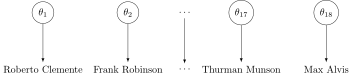

In [17]:
SVG("assets/baseball/no-pooling-dag.svg")

`No-pooling` is the polar opposite to `complete-pooling`, where instead of
treating each player identically we will treat each player as having their own
separate chance of landing a hit when at-bat. Essentially we will be creating a
model for each player (every player has their own distribution to sample from,
$\theta$) and each model will have no influence on any of the other models. We
will see later on that choosing a `no-pooling` model overestimates top batter's
chances while underestimating poor batter's chances. Note that this is the
opposite to what the `complete-pooling` model did and to our data story that
says players are _similar_ not exactly unique.

We will use Bean Machine to create this type of model as follows.

$$
\begin{align}
  \theta&\sim\text{Beta}(1, 1)\\
  y&\sim\text{Binomial}(K, \theta)
\end{align}
$$

In [18]:
@bm.random_variable
def no_pooling_theta() -> RVIdentifier:
    return dist.Beta(1, 1).expand((N,))


@bm.random_variable
def no_pooling_y() -> RVIdentifier:
    return dist.Binomial(current_at_bats, no_pooling_theta())

Coding the `no-pooling` and `complete-pooling` models are quite similar. Note
that the difference between the two models is that we use `expand` on the prior
and not in the likelihood.

#### No-pooling inference

Just like before we will use the `GlobalNoUTurnSampler` inference method. We
construct the observations dictionary exactly to how we constructed it in the
`complete-pooling` model.

In [19]:
no_pooling_observations = {no_pooling_y(): current_hits}

The queries we are interested in from this model are all the $\theta$'s as they
are the distributions for each player's individual chances of landing a hit.

In [20]:
no_pooling_queries = [no_pooling_theta()]
no_pooling_samples = bm.GlobalNoUTurnSampler().infer(
    queries=no_pooling_queries,
    observations=no_pooling_observations,
    num_samples=num_samples,
    num_chains=4,
    num_adaptive_samples=num_adaptive_samples,
    verbose=VerboseLevel.OFF,
)

#### No-pooling analysis

Again we will start our analysis of our no pooling model with summary statistics
and trace plots.

In [21]:
no_pooling_summary_df = az.summary(no_pooling_samples.to_xarray(), round_to=4)
no_pooling_summary_df

,mean,sd,hdi_5.5%,hdi_94.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
no_pooling_theta()[0],0.4050,0.0722,0.2903,0.5221,0.0004,0.0003,34938.3006,15139.8314,1.0002
no_pooling_theta()[1],0.3826,0.0691,0.2723,0.4945,0.0004,0.0003,34738.6993,15421.2848,1.0002
no_pooling_theta()[2],0.3613,0.0697,0.2525,0.4753,0.0004,0.0003,34413.1646,13596.0820,1.0001
no_pooling_theta()[3],0.3400,0.0684,0.2287,0.4462,0.0004,0.0003,33227.4688,14965.2042,1.0000
no_pooling_theta()[4],0.3189,0.0672,0.2082,0.4218,0.0004,0.0003,31316.6433,13258.4562,1.0003
no_pooling_theta()[5],0.3188,0.0676,0.2122,0.4273,0.0004,0.0003,33478.8492,14347.0224,0.9999
no_pooling_theta()[6],0.2980,0.0664,0.1946,0.4053,0.0004,0.0003,35044.9560,14599.9200,1.0002
no_pooling_theta()[7],0.2765,0.0636,0.1755,0.3768,0.0003,0.0003,34248.5416,14171.6154,1.0001
no_pooling_theta()[8],0.2550,0.0625,0.1562,0.3538,0.0003,0.0003,32632.5682,14333.3081,1.0000
no_pooling_theta()[9],0.2557,0.0625,0.1517,0.3501,0.0003,0.0002,33397.0808,15053.2886,1.0000


All the $\hat{R}$ values look close to 1, and our `ess` for both the bulk and
tail regions are large. Below we plot all the diagnostics we did for the
`complete-pooling` model above. Since we created a model for each player, we
have a large number of diagnostic plots.

In [22]:
no_pooling_diagnostic_plots = baseball.plot_no_pooling_diagnostics(
    no_pooling_samples,
    no_pooling_theta(),
    df,
)
show(gridplot([*no_pooling_diagnostic_plots]))

All of our visual diagnostics above look good. Posteriors are smooth, `ess`
plots look linear, density and rank plots for each chain look uniform and
autocorrelation plots are decent. Our model successfully created parameters for
each player (all the $\theta$s). From the posterior plots (the plots with the
HDI statements) we can see that the players have different chances of hitting a
when at-bat. Roberto Clemente appears to have a much higher chance of getting a
hit than Max Alvis does.

In the below plot we show the predicted chance of landing a hit when at-bat for
our first two models. As we stated at the beginning of this section the
no-pooling model underestimates weak hitting player's chances of a hit, and
overestimates good hitting player's chances of a hit. Recall that the
complete-pooling model did the exact opposite, which was to overestimate weak
player's chances of hitting and underestimating strong player's chances of
hitting when at-bat.  This effect is quite apparent when looking at the
no-pooling plot to the right _vs_ the complete-pooling plot on the left.

We again plot posterior means for each player and the whiskers show the 89%
HDI. The grey line is found by setting

$$
y = \frac{\text{Current hits}}{\text{Current at-bats}}.
$$

Since this is also our x-axis, we have a straight line.

In [23]:
no_pooling_model_plot = baseball.plot_no_pooling_model(
    no_pooling_samples,
    no_pooling_theta(),
    df,
)
show(gridplot([[complete_pooling_model_plot, no_pooling_model_plot]]))

Player's chances for the no-pooling model show a wide spread from around 0.2 to
around 0.4. It turns out that a hitting average for MLB players in the high
300's (0.3 in our model) is quite rare, see [Wikipedia
(All-time-players)](#references) for historical context. Our no-pooling model
certainly overestimated strong player's chances of landing a hit when at-bat,
and it did so with gusto.

So far we have not done a good job of telling our data story through our
models. Our complete-pooling model said every player was the same, while our
no-pooling model said all players are uniquely different. However, our data
story said that all players are different, but similar. What we have done so
far is to model the extreme cases for our data. In the next section we will
combine these two models such that we have a more accurate representation of
player's chances when at-bat.

<a id="parital-pooling"></a>
### Partial-pooling model

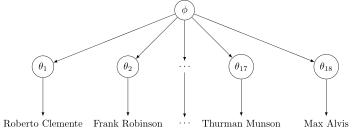

In [24]:
SVG("assets/baseball/partial-pooling-dag.svg")

Partial pooling combines [complete-pooling](#complete-pooling) and
[no-pooling](#no-pooling) models to create a hybrid model that creates separate
models for each player _and simultaneously_ models the population. We do not
have any data on the MLB population, but we can still create a model of it
through our hierarchical model. Essentially what the model does is create
separate parameters for each player (the $\theta$s) and assumes that each
$\theta$ is sampled from the same distribution $(\phi)$, see above. The
partial-pooling model does a better job of estimating all batter's chances
using information about the population. It will also do a better job of
estimating poor hitter's chances and good hitter's chances.

Our model is then

$$
\begin{align}
  \phi&\sim\text{Beta}(1, 1)\\
  \kappa&\sim\text{Pareto}(1, 1.5)\\
  \theta&\sim\text{Beta}(\phi * \kappa, (1- \phi) * \kappa)\\
  y&\sim\text{Binomial}(K, \theta)
\end{align}
$$

The new component of the model is the $\kappa$ parameter, which is sampled from
a `Pareto` distribution. $\kappa$ has been introduced to this model because
$\theta$, the distribution for each player's chance of getting a hit when
at-bat, has priors $\alpha$ and $\beta$, which both need to be estimated.
$\kappa$ can be thought of as the population "concentration". For a more
thorough discussion about $\kappa$, see [Carpenter 2016](#references).

#### Priors for the partial-pooling model

Just as we did before, we plot a few curves of the Pareto distribution with
varying parameters to get a sense of what our priors look like.

In [25]:
show(baseball.plot_pareto_prior())

We can code our partial pooling model easily in Bean Machine. All we need to do
is reintroduce $\phi$ as our estimate for the population's chance for hitting a
ball when at-bat, keep our model for each individual's chance for successfully
hitting when at-bat $\theta$, and introduce $\kappa$ as our population
concentration.

In [26]:
@bm.random_variable
def partial_pooling_phi() -> RVIdentifier:
    return dist.Beta(1, 1)


@bm.random_variable
def partial_pooling_kappa() -> RVIdentifier:
    return dist.Pareto(1, 1.5)


@bm.random_variable
def partial_pooling_theta() -> RVIdentifier:
    alpha = partial_pooling_phi() * partial_pooling_kappa()
    beta = (1 - partial_pooling_phi()) * partial_pooling_kappa()
    return dist.Beta(alpha, beta).expand((N,))


@bm.random_variable
def partial_pooling_y() -> RVIdentifier:
    return dist.Binomial(current_at_bats, partial_pooling_theta())

#### Partial-pooling inference

Again we construct our observations into a dictionary, and sample using the
`GlobalNoUTurnSampler`. The major difference between our previous models and
this one, is that we now have more than one Bean Machine random variable to
include in the `queries` parameter of the `infer` method.

In [27]:
partial_pooling_observations = {partial_pooling_y(): current_hits}
partial_pooling_queries = [
    partial_pooling_kappa(),
    partial_pooling_phi(),
    partial_pooling_theta(),
]
partial_pooling_samples = bm.GlobalNoUTurnSampler().infer(
    queries=partial_pooling_queries,
    observations=partial_pooling_observations,
    num_samples=num_samples,
    num_chains=4,
    num_adaptive_samples=num_adaptive_samples,
    verbose=VerboseLevel.OFF,
)

#### Partial-pooling analysis

Just as before, we check the $\hat{R}$ and `ess` summary statistics as well as the
rank and autocorrelation plots using arviz.

In [28]:
partial_pooling_summary_df = az.summary(partial_pooling_samples.to_xarray(), round_to=4)
partial_pooling_summary_df

,mean,sd,hdi_5.5%,hdi_94.5%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
partial_pooling_theta()[0],0.3224,0.0522,0.2370,0.4007,0.0005,0.0004,9835.3061,10226.7946,1.0001
partial_pooling_theta()[1],0.3135,0.0497,0.2372,0.3935,0.0005,0.0003,11348.6529,9506.8213,1.0002
partial_pooling_theta()[2],0.3046,0.0480,0.2308,0.3812,0.0004,0.0003,12646.2602,13233.1008,1.0002
partial_pooling_theta()[3],0.2954,0.0467,0.2219,0.3677,0.0004,0.0003,14546.1974,13362.5957,1.0003
partial_pooling_theta()[4],0.2856,0.0451,0.2140,0.3563,0.0003,0.0002,21003.5850,14269.1015,1.0007
partial_pooling_theta()[5],0.2859,0.0456,0.2118,0.3556,0.0003,0.0002,20082.7864,14973.8566,1.0005
partial_pooling_theta()[6],0.2771,0.0447,0.2048,0.3455,0.0003,0.0002,21698.8238,13905.8471,1.0000
partial_pooling_theta()[7],0.2678,0.0443,0.1941,0.3354,0.0003,0.0002,22866.5342,14478.3828,1.0003
partial_pooling_theta()[8],0.2585,0.0428,0.1905,0.3264,0.0003,0.0002,21701.7621,13498.0131,1.0003
partial_pooling_theta()[9],0.2584,0.0437,0.1892,0.3275,0.0003,0.0002,21760.7532,12872.8877,1.0011


In [29]:
plots = [*baseball.plot_partial_pooling_diagnostics(partial_pooling_samples, df)]
show(gridplot(plots))

All summary diagnostics $(\hat{R}\text{ and }ess$) look good. All our `ess`
evolution plots also look linear and breach the 400 rule-of-thumb threshold.
Rank plots all look fairly uniform and our autocorrelation plots look good. You
will notice that the autocorrelation plot for $\kappa$ has highly correlated
draws with initial lags. We could sample for longer chains in order to try and
alleviate these correlations.

Below we show how the model affects estimated chances of hitting when at-bat
for each player. We compare this new model to the other model plots and see
that the partial-pooling model effectively increases weak player's chances of
landing a hit, while also decreasing strong player's chances of a hit.

In [30]:
partial_pooling_model_plot = baseball.plot_partial_pooling_model(
    partial_pooling_samples,
    df,
)
plots = [complete_pooling_model_plot, no_pooling_model_plot, partial_pooling_model_plot]
show(gridplot([plots]))

The partial-pooling model has shifted our predictions. In fact, it has captured
our data story, which stated that MLB players are unique (they do not lie on the
population mean orange line) and yet they are not all that different (they do
not fall on the grey line). What we see is that player's chances of hitting a
ball when at-bat have moved closer to the mean line from their positions in the
no-pooling model.

In [31]:
show(baseball.plot_shrinkage(no_pooling_samples, partial_pooling_samples, df))

## Conclusion

To sum up

* Our complete-pooling model

  * overestimated weak player's chances of landing a hit
  * underestimated strong player's chances of landing a hit
  * gave us posterior mean estimates within the population mean.


* Our no-pooling model

  * underestimated weak player's chances of landing a hit
  * overestimated strong player's chances of landing a hit.


* Our partial-pooling model

  * estimated a player's chance of landing a hit regardless if they hit poorly
    or well.


With our limited data we were able to create a model that gives us a player's
chance of success when at-bat. Bayesian inference has given us a way to make
more accurate predictions about a player's chance of success with a small data
set and Bean Machine made creating those models very easy.

<a id="references"></a>
## References

* Carpenter B (2016) Hierarchical Partial Pooling for Repeated Binary Trials.
  [https://mc-stan.org/users/documentation/case-studies/pool-binary-trials.html](https://mc-stan.org/users/documentation/case-studies/pool-binary-trials.html)
* Efron B and Morris C (1975) Data analysis using Stein's estimator and its
  generalizations. _Journal of the American Statistical Association_ **70**(350),
  311–319 [doi: 10.1080/01621459.1975.10479864](https://dx.doi.org/10.1080/01621459.1975.10479864).
* Efron B and Morris C (1977) Stein's Paradox in Statistics. _Scientific
  American_ **236**(5), 119–127 [JSTOR](https://www.jstor.org/stable/24954030).
* McElreath R (2020) **Statistical Rethinking: A Bayesian Course with Examples
  in R and Stan** 2nd edition. Chapman and Hall/CRC.
  [doi: 10.1201/9780429029608](https://dx.doi.org/10.1201/9780429029608)
* $N_{\text{eff}}$ [MCMC Handbook](https://www.mcmchandbook.net/HandbookChapter1.pdf)
* $\hat{R}$ [Project Euclid](https://projecteuclid.org/euclid.ss/1177011136)
* Tarone RE (1982) The use of historical control information in testing for a
  trend in proportions. _Biometrics_ **38**(1):215–220
  [doi: 10.2307/2530304](https://doi.org/10.2307/2530304)
  [doi: 10.1214/20-BA1221](https://dx.doi.org/10.1214/20-BA1221)
* [Wikipedia (All-time-players)](https://en.wikipedia.org/wiki/Batting_average_(baseball)#All-time_leaders)
* [Wikipedia (Bernoulli trials)](https://en.wikipedia.org/wiki/Bernoulli_trial)
* [Wikipedia (Binomial)](https://en.wikipedia.org/wiki/Binomial_distribution)
* [Wikipedia (Major League Baseball)](https://en.wikipedia.org/wiki/Major_League_Baseball)